In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np

import pandas as pd
import xarray as xr

import matplotlib.pyplot as plt
from cartopy import crs as ccrs
import matplotlib.pyplot as plt
import matplotlib as mpl
from yllib.plot import plot_map

%config InlineBackend.figure_format='retina'


In [2]:
root_dir = '/global/cfs/projectdirs/m1657/liuy351/TallTower/ContrastiveTransformer'
data_dir = '/global/cfs/projectdirs/m1657/liuy351/TallTower/ERA5_reduced'

In [3]:
option = 'allmean'
feature_path = f'../runs/transformer_embedding.s.e10b128.2001-2024.{option}.pt'
time_idx_path = f'../data/processed/preprocessed_data_time.2001-2024.{option}.csv'
linkage_path = f'../runs/linkage_metrix.s.e10b128.2001-2024.{option}.npy'
clustering_label_path = f'../runs/clustering_linkage.s.e10b128.2001-2024.JJA.{option}.nc'

In [4]:
cluster_labels = xr.open_dataset(clustering_label_path)['cluster']
cluster_labels

<xarray.DataArray 'cluster' (time: 50784, threshold: 8)> Size: 2MB
[406272 values with dtype=int32]
Coordinates:
  * time       (time) datetime64[ns] 406kB 2001-06-01 ... 2023-08-31T23:00:00
  * threshold  (threshold) int64 64B 5000 6000 7000 8000 9000 10000 11000 15000

In [5]:
from IPython.display import display
pd.options.display.max_columns = None
pd.options.display.max_rows = 10
cluster_labels.to_pandas().to_csv('test.csv')
cluster_labels.sel(time=slice('2023-08-01 00:00', '2023-08-31 00:00')).to_pandas()

threshold,5000,6000,7000,8000,9000,10000,11000,15000
time,,,,,,,,
2023-08-01 00:00:00,6,4,2,2,1,1,1,1
2023-08-01 01:00:00,6,4,2,2,1,1,1,1
2023-08-01 02:00:00,6,4,2,2,1,1,1,1
2023-08-01 03:00:00,6,4,2,2,1,1,1,1
2023-08-01 04:00:00,6,4,2,2,1,1,1,1
...,...,...,...,...,...,...,...,...
2023-08-30 20:00:00,7,5,3,3,2,2,2,2
2023-08-30 21:00:00,7,5,3,3,2,2,2,2
2023-08-30 22:00:00,7,5,3,3,2,2,2,2


## Composite analysis

In [6]:
for threshold in cluster_labels.coords['threshold']:
    print(f'Threshold: {threshold.data}, in total {np.unique(cluster_labels.sel(threshold=threshold)).size} clusters')


Threshold: 5000, in total 19 clusters
Threshold: 6000, in total 13 clusters
Threshold: 7000, in total 10 clusters
Threshold: 8000, in total 7 clusters
Threshold: 9000, in total 5 clusters
Threshold: 10000, in total 5 clusters
Threshold: 11000, in total 4 clusters
Threshold: 15000, in total 3 clusters


In [7]:
threshold = 11000
labels = cluster_labels.sel(threshold=threshold)
unique_labels = np.unique(labels)
ncluster = unique_labels.size
print(f'Threshold selected: {threshold}, in total {ncluster} clusters')

Threshold selected: 9000, in total 5 clusters


In [8]:
labels = labels.sel(time=slice('2023-06-01 00:00', '2023-08-31 23:00'))
labels

<xarray.DataArray 'cluster' (time: 2208)> Size: 9kB
array([5, 5, 5, ..., 2, 2, 2], dtype=int32)
Coordinates:
  * time       (time) datetime64[ns] 18kB 2023-06-01 ... 2023-08-31T23:00:00
    threshold  int64 8B 9000

In [9]:
def calc_cluster(data, labels, rdim='time'):
    time = np.intersect1d(data.time, labels.time)
    data = data.sel(time=time)
    labels = labels.sel(time=time)
    data = data.assign_coords(label=(rdim, labels.data))#["bmu"] = bmu.astype(np.float)
    clusters = []
    cluster_mean = []
    pct = []
    unique_label = np.unique(labels)
    for _label in unique_label:
        cluster = data.where(data["label"]==_label, drop=True)
        if cluster.coords[rdim].size==0:
            clusters.append(None)
            cluster_mean.append(None)
            pct.append(0.)
        else:
            clusters.append(cluster)
            cluster_mean.append(cluster.mean("time"))
            pct.append(len(cluster.coords["label"]) / len(data.coords["label"]) * 100.)
    return clusters, cluster_mean, pct

In [10]:
def read_met_data(var, vname, time):
    # fname = f'{datadir}/{var}.2001-2024.anomaly.nc'
    fname = f'{data_dir}/{var}.2001-2024.nc'
    with xr.open_dataset(fname) as ds:
        da = ds[vname].squeeze()
        time = np.intersect1d(da.time, time)
        da = da.sel(time=time)
    return da

In [11]:
sp = read_met_data('sp', 'SP', labels.time) / 100.
t2 = read_met_data('2t', 'VAR_2T', labels.time) -273.15
z500 = read_met_data('z500', 'Z', labels.time) / 100.
z850 = read_met_data('z850', 'Z', labels.time) / 100
t500 = read_met_data('t500', 'T', labels.time)
t850 = read_met_data('t850', 'T', labels.time)
u100 = read_met_data('100u', 'VAR_100U', labels.time)
v100 = read_met_data('100v', 'VAR_100V', labels.time)

sp

<xarray.DataArray 'SP' (time: 2208, latitude: 37, longitude: 45)> Size: 15MB
array([[[ 980.9945 ,  962.22455,  939.6345 , ...,  796.3845 ,
          797.78455,  833.53455],
        [1007.29456,  992.4545 ,  969.7545 , ...,  813.22455,
          813.10455,  841.5645 ],
        [1016.92456, 1009.8145 , 1004.8245 , ...,  831.54456,
          830.7045 ,  858.6145 ],
        ...,
        [1021.40454, 1020.9545 , 1020.35455, ...,  814.03455,
          801.79456,  791.4345 ],
        [1021.22455, 1020.8245 , 1020.16455, ...,  810.14453,
          798.98456,  798.6845 ],
        [1021.1345 , 1020.65454, 1020.23456, ...,  822.1845 ,
          811.3045 ,  811.5645 ]],

       [[ 980.8667 ,  962.1267 ,  939.58673, ...,  796.34674,
          797.65674,  833.3267 ],
        [1007.16675,  992.34674,  969.6867 , ...,  813.1167 ,
          813.02673,  841.46674],
        [1016.8067 , 1009.7067 , 1004.71674, ...,  831.4267 ,
          830.6367 ,  858.53674],
...
        [1013.46545, 1013.1155 , 1012.6755 , ...,  814.60547,
          802.5455 ,  792.33545],
        [1013.4255 , 1013.1355 , 1012.6355 , ...,  811.4355 ,
          800.16547,  799.57544],
        [1013.45544, 1013.09546, 1012.8655 , ...,  823.2355 ,
          812.2355 ,  812.20544]],

       [[ 974.183  ,  956.14294,  934.553  , ...,  798.65295,
          800.03296,  836.313  ],
        [ 999.04297,  984.623  ,  962.923  , ...,  815.613  ,
          815.503  ,  844.573  ],
        [1008.383  , 1001.21295,  996.243  , ...,  834.063  ,
          833.233  ,  861.77295],
        ...,
        [1013.28296, 1012.943  , 1012.51294, ...,  814.483  ,
          802.383  ,  792.01294],
        [1013.233  , 1012.95294, 1012.46295, ...,  811.233  ,
          799.933  ,  799.20294],
        [1013.253  , 1012.883  , 1012.65295, ...,  822.91296,
          811.863  ,  811.71295]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 18kB 2023-06-01 ... 2023-08-31T23:00:00
  * longitude  (longitude) float64 360B 233.0 233.2 233.5 ... 243.5 243.8 244.0
  * latitude   (latitude) float64 296B 50.0 49.75 49.5 49.25 ... 41.5 41.25 41.0

In [12]:
clusters, cluster_means, pcts = {}, {}, {}
vnames = ['sp', 't2', 'z500', 'z850', 't500', 't850', 'u100', 'v100']
vars = [sp, t2, z500, z850, t500, t850, u100, v100]
for vname, v in zip(vnames, vars):
    clusters[vname], cluster_means[vname], pcts[vname] = calc_cluster(v, labels)


**Create daily labels**

/tmp/ipykernel_704825/1600792124.py:2: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  new_time = pd.date_range(start='2023-08-01 00:00', end='2023-11-30 00:00', freq='30T')


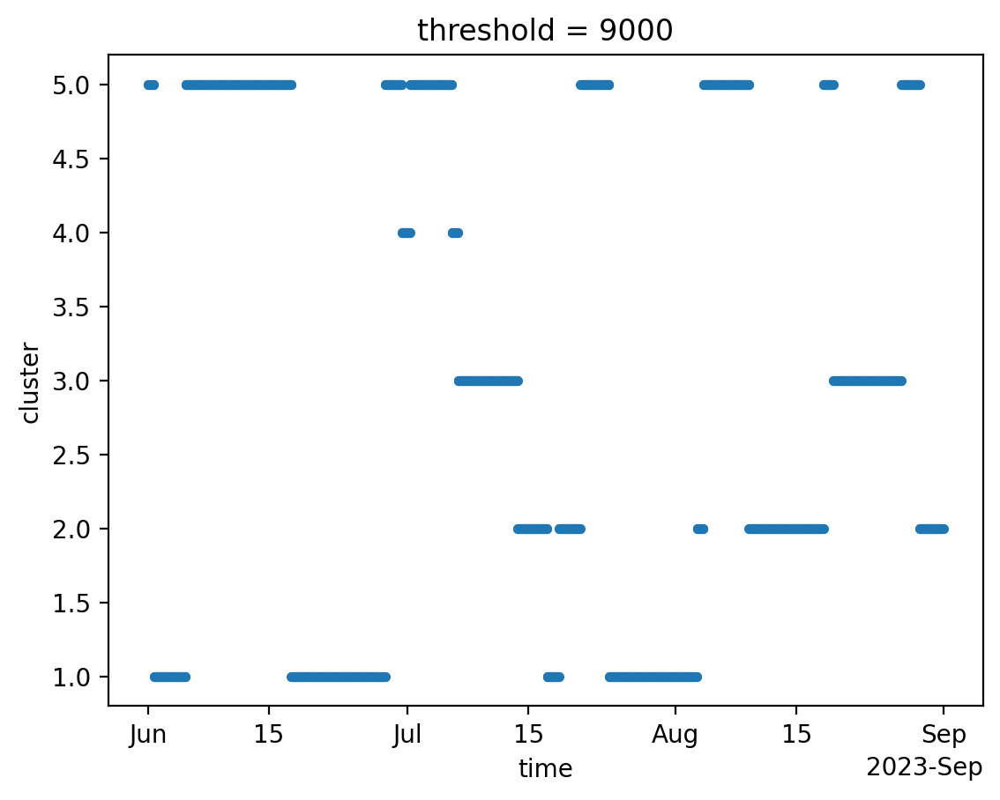

In [13]:
label_daily = labels.sel(time=slice('2023-07-31 00:00','2023-11-30 00:00'))
new_time = pd.date_range(start='2023-08-01 00:00', end='2023-11-30 00:00', freq='30T')
label_daily = label_daily.reindex(time=new_time, method='ffill')
# label_daily = label_daily.ffill(dim='time')
labels.plot(ls='none', marker='.')

In [14]:
labels.sel(time=slice('2023-08-11 00:00','2023-08-25 00:00')).to_pandas()

time
2023-08-11 00:00:00    2
2023-08-11 01:00:00    2
2023-08-11 02:00:00    2
2023-08-11 03:00:00    2
2023-08-11 04:00:00    2
                      ..
2023-08-24 20:00:00    3
2023-08-24 21:00:00    3
2023-08-24 22:00:00    3
2023-08-24 23:00:00    3
2023-08-25 00:00:00    3
Length: 337, dtype: int32

In [15]:
wind_lidar = []
for m in [8,9,10,11]:
    wind_lidar.append(xr.open_dataset(f'../../DATA/sonia_lidar/lidar_2023_{m:02d}.nc'))
wind_lidar = xr.concat(wind_lidar, dim='time')
wind_lidar = wind_lidar.where(wind_lidar<1000.)
wind_lidar = wind_lidar.resample(time='30T').mean() 
wind_lidar

/global/homes/y/yeliu/.conda/envs/compute/lib/python3.11/site-packages/xarray/core/groupby.py:668: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  index_grouper = pd.Grouper(


<xarray.Dataset> Size: 2MB
Dimensions:  (level: 11, time: 5856)
Coordinates:
  * level    (level) float64 88B 84.0 94.0 104.0 112.0 ... 184.0 204.0 224.0
  * time     (time) datetime64[ns] 47kB 2023-08-01 ... 2023-11-30T23:30:00
Data variables:
    uv       (time, level) float64 515kB 3.816 4.295 4.568 ... 4.226 4.379 4.533
    wdir     (time, level) float64 515kB 269.5 267.6 267.3 ... 171.6 170.8 169.8
    w        (time, level) float64 515kB -0.1361 -0.08586 ... -1.223 -1.198

In [16]:
def calc_cluster_lidar(data, labels, rdim='time'):
    time = np.intersect1d(data.time, labels.time)
    data = data.sel(time=time)
    labels = labels.sel(time=time)
    data = data.assign_coords(label=(rdim, labels.data))#["bmu"] = bmu.astype(np.float)
    clusters = []
    cluster_mean = []
    pct = []
    unique_label = np.unique(labels)
    for _label in unique_label:
        cluster = data.where(data["label"]==_label, drop=True)
        if cluster.coords[rdim].size==0:
            clusters.append(None)
            cluster_mean.append(None)
            pct.append(0.)
        else:
            clusters.append(cluster)
            cluster_mean.append(cluster.mean("time"))
            pct.append(len(cluster.coords["label"]) / len(data.coords["label"]) * 100.)
    return clusters, cluster_mean, pct
lidar_clusters, lidar_cluster_means, lidar_pcts = calc_cluster_lidar(wind_lidar, label_daily)

In [17]:
len(lidar_cluster_means)

4

In [18]:
map_extent = [-127, -116, 41, 50]
wind_extent = [-124, -119, 43, 48]
WREF_location = [-121.9519, 45.8205]
lat = sp.latitude
lon = sp.longitude


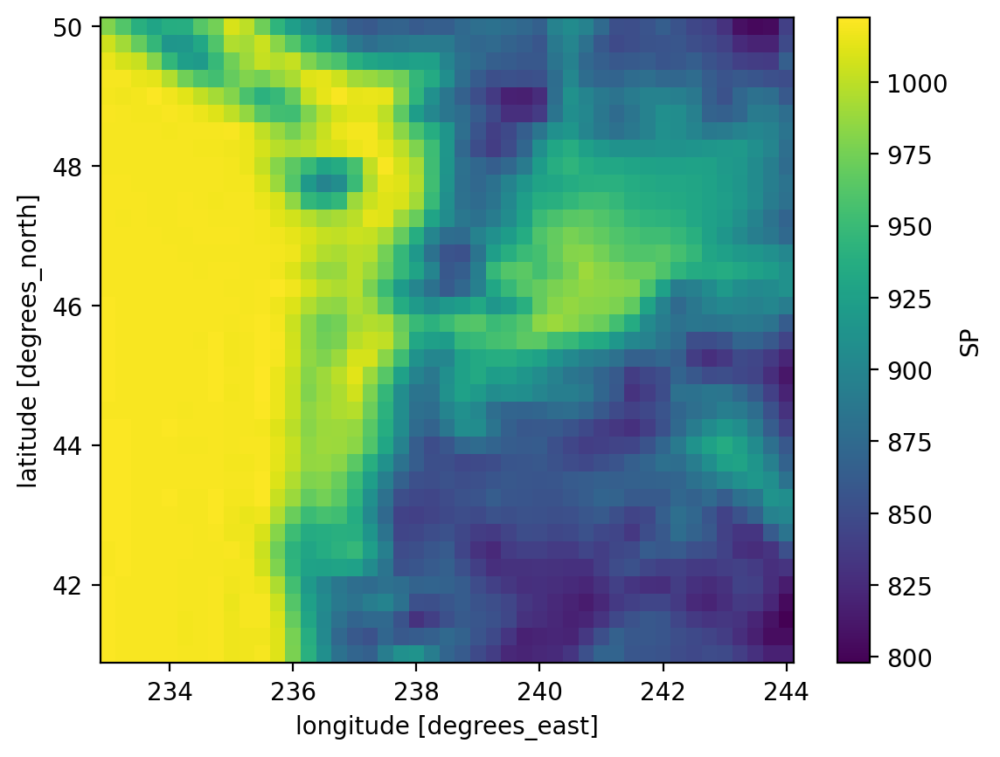

In [19]:
cluster_means['sp'][0].plot()

In [20]:
topo = xr.open_dataset(f'../../ERA5_reduced/e5.oper.invariant.128_129_z.ll025sc.1979010100_1979010100.nc')['Z'].squeeze() / 9.8
topo = topo.sel(longitude=slice(map_extent[0]+360, map_extent[1]+360), latitude=slice(map_extent[3], map_extent[2]))

(0.5, 0.5)


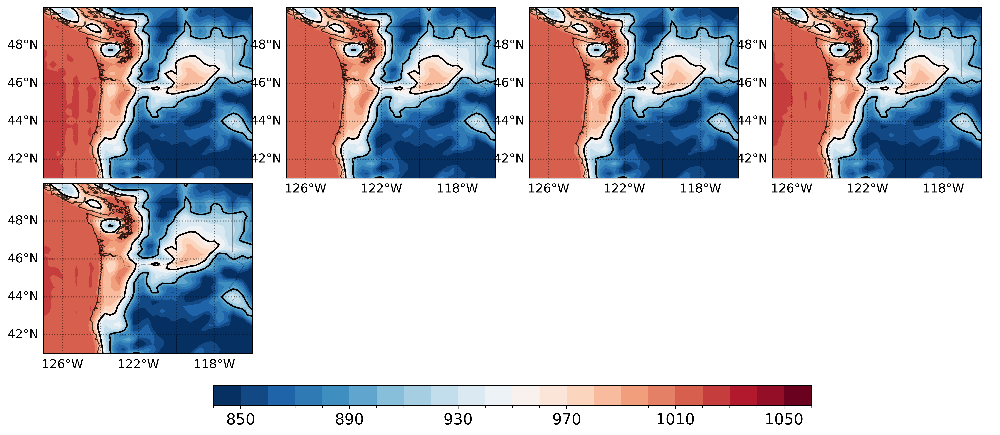

In [21]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 6), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.03, wspace=0.05)

abcd=list('abcdefghijk')
levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = cluster_means['sp'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(850,1050,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        # cmap=cm_wind['cmap'],
        cmap='MPL_RdBu_r',
        # overlay=p,
        # title=f'({abcd[i]}) {levelstr[i]} '+r'($10^{-2}\ g\ kg^{-1}$)',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='k', levels=[500,1000])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

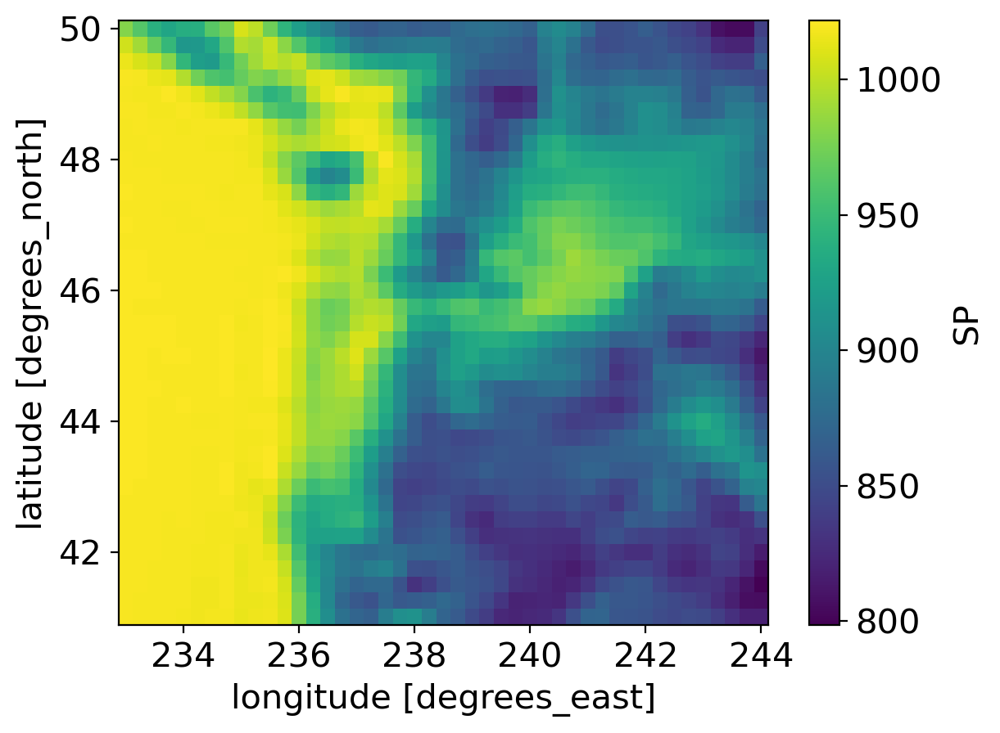

In [22]:
v.plot()

(0.5, 0.5)


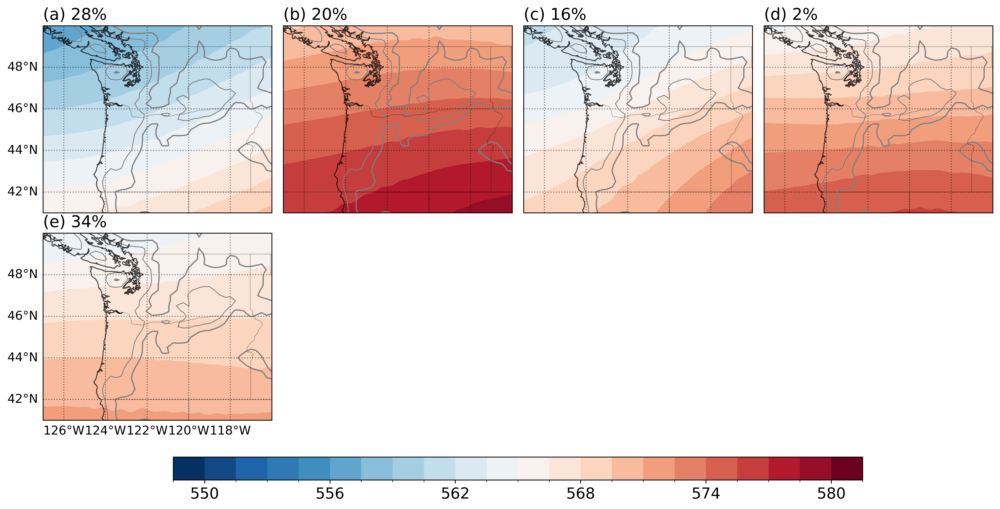

In [23]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = cluster_means['z500'][i]
    pct = pcts['z500'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(550,580,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

(0.5, 0.5)


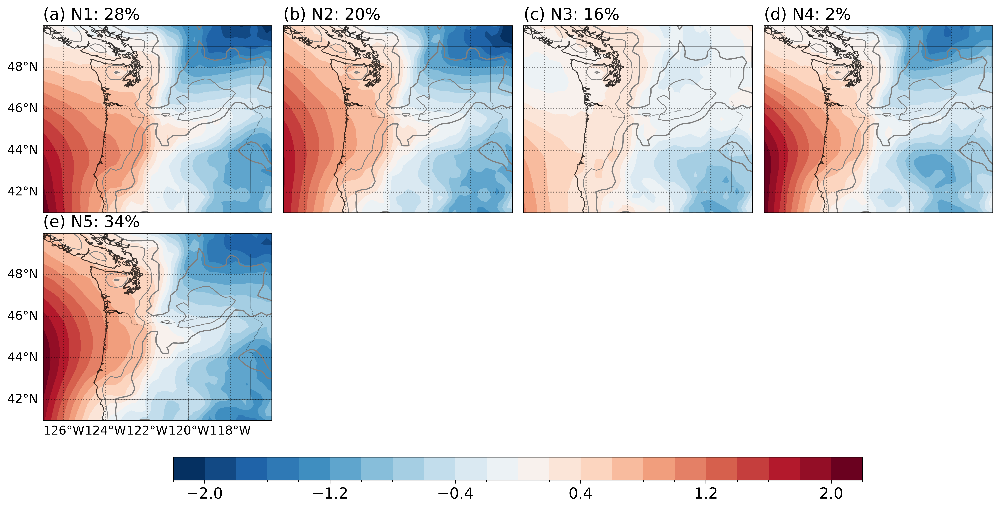

In [24]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = cluster_means['z850'][i]
    v = v - v.mean(['latitude','longitude'])
    pct = pcts['z850'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(-2,2,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

(0.5, 0.5)


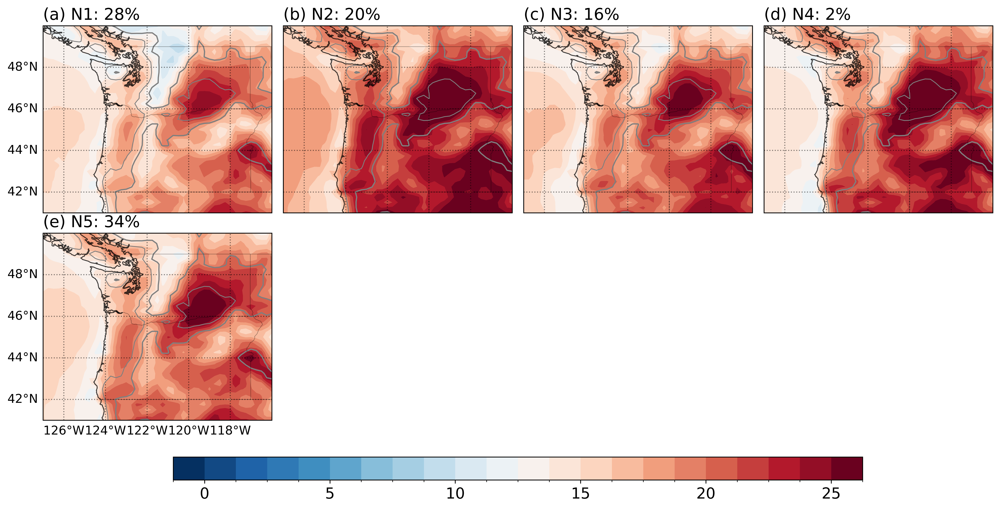

In [25]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = cluster_means['t2'][i]
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(0,25,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

(0.5, 0.5)


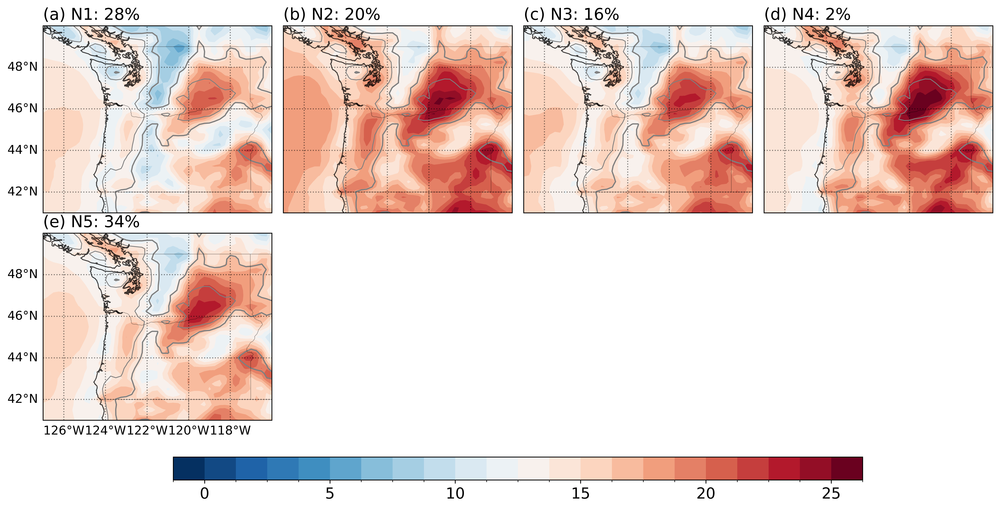

In [26]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = clusters['t2'][i]
    # v = v.sel(time=v['time.hour'].isin([15,16,17,18,19,20,21,22,23,0,1,2,3])).mean('time')
    v = v.sel(time=v['time.hour'].isin([4,5,6,7,8,9,10,11,12,13,14])).mean('time')
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(0,25,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

In [27]:
clusters['t2']

[<xarray.DataArray 'VAR_2T' (time: 626, latitude: 37, longitude: 45)> Size: 4MB
 array([[[10.130005 , 10.698364 , 11.032349 , ..., 12.149536 ,
          12.253052 , 14.880005 ],
         [ 9.491333 , 10.262817 , 10.596802 , ..., 13.23938  ,
          13.190552 , 15.4366455],
         [ 9.508911 ,  9.844849 , 10.0772705, ..., 14.4366455,
          14.360474 , 16.536255 ],
         ...,
         [12.102661 , 12.071411 , 12.159302 , ..., 14.380005 ,
          13.3116455, 12.872192 ],
         [12.08313  , 11.985474 , 12.065552 , ..., 14.2803955,
          13.641724 , 13.8585205],
         [12.096802 , 12.047974 , 12.094849 , ..., 15.8428955,
          15.288208 , 15.444458 ]],
 
        [[10.662628 , 11.397003 , 12.037628 , ..., 12.563019 ,
          12.838409 , 15.561066 ],
         [ 9.563019 , 10.500519 , 11.147003 , ..., 13.955597 ,
          14.139191 , 16.553253 ],
         [ 9.537628 ,  9.949738 , 10.193878 , ..., 15.357941 ,
          15.533722 , 17.928253 ],
 ...
         [18.082

(0.5, 0.5)


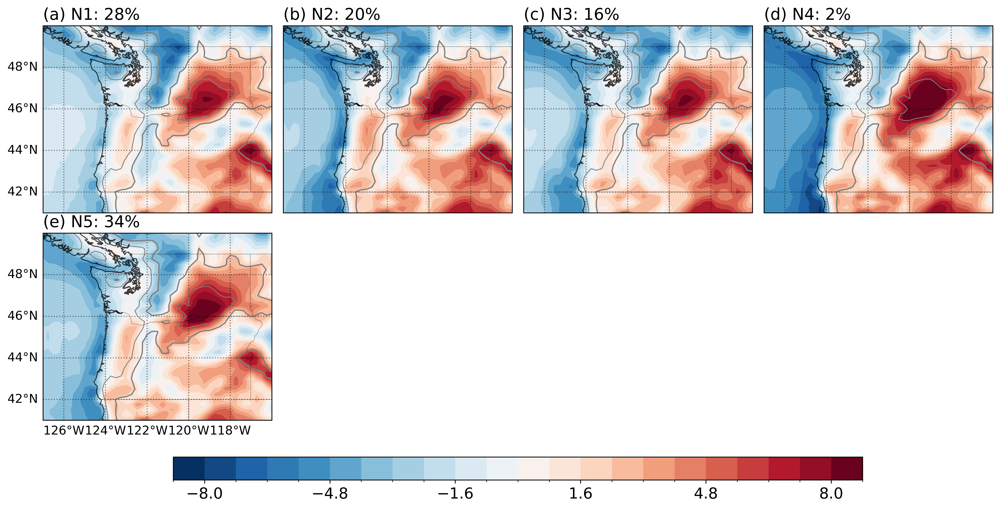

In [28]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(14, 7), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.08, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    v = cluster_means['t2'][i] 
    v = v - v.mean(['latitude', 'longitude'])
    pct = pcts['t2'][i]
    # p = pval_urb_qcloud.isel(level=i, som=0)
    ax = axs[i]
    cs, clev = plot_on_map(
        v,
        fig=fig, ax=ax, extent=map_extent,
        clev=[-10000]+list(np.linspace(-8,8,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        cmap='MPL_RdBu_r',
        # overlay=p,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])

_=plot_map.add_colorbar(cs, axs, clev[1:-1:4], pad=0.08, shrink=0.8)

(0.5, 0.5)


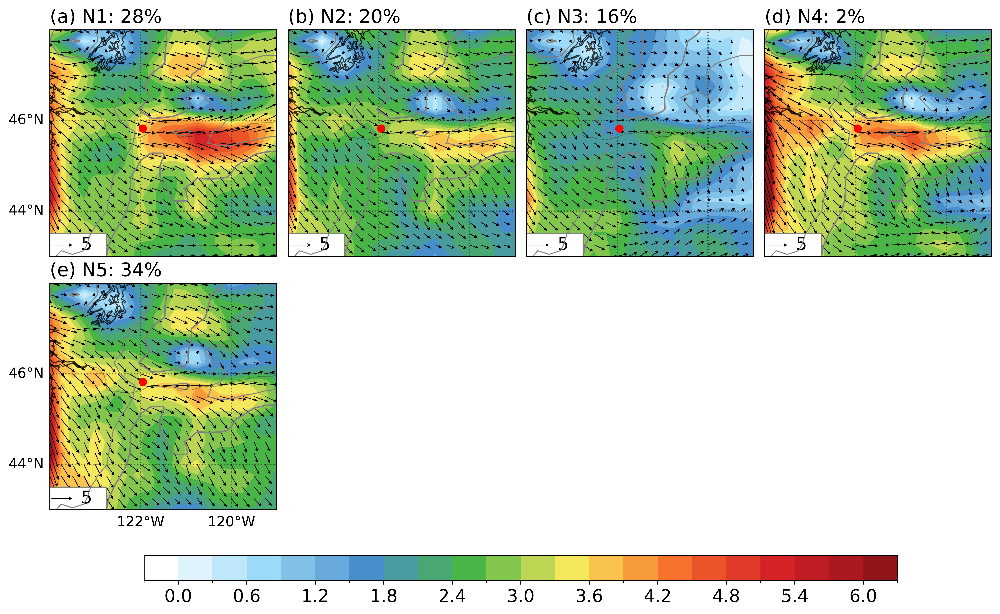

In [29]:
from func_plot_on_map import plot_on_map
projection = ccrs.PlateCarree()

fig, axs = plt.subplots(
    2, 4, figsize=(12, 7.5), 
    subplot_kw={'projection': projection},
    dpi=300,
)
axs = axs.ravel()
for ax in axs: ax.set_axis_off()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.05, wspace=0.05)

abcd=list('abcdefghijk')
# levelstr = ['Low','Med','Hig']
for i in np.arange(ncluster):
    # var = cluster_means['t2'][i]
    u = clusters['u100'][i]
    u = u.sel(time=u['time.hour'].isin([15,16,17,18,19,20,21,22,23,0,1,2,3])).mean('time')
    # u = u.sel(time=u['time.hour'].isin([4,5,6,7,8,9,10,11,12,13,14])).mean('time')
    v = clusters['v100'][i]
    v = v.sel(time=v['time.hour'].isin([15,16,17,18,19,20,21,22,23,0,1,2,3])).mean('time')
    # v = v.sel(time=v['time.hour'].isin([4,5,6,7,8,9,10,11,12,13,14])).mean('time')
    pct = pcts['t2'][i]
    var = np.sqrt(u*u + v*v)
    ax = axs[i]
    cs, clev = plot_on_map(
        var,
        fig=fig, ax=ax, extent=wind_extent,
        clev=[-10000]+list(np.linspace(0,6,21))+[10000],
        draw_colorbar=False,
        lat=lat, lon=lon,
        u=u, v=v,
        vector_scale=20,
        # cmap=cm_wind['cmap'],
        cmap='WhiteBlueGreenYellowRed',
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
        title=f'({abcd[i]}) N{i+1}: {pct:.0f}%',
        title_kwargs=dict(fontsize=16),
    )
    ax.contour(topo.longitude, topo.latitude, topo, colors='tab:gray', levels=[500,1000], linewidths=[0.8,1.2])
    plot_map.add_geolocation(ax, WREF_location)


_=plot_map.add_colorbar(cs, axs, clev[1:-1:2], pad=0.08, shrink=0.8)

IndexError: list index out of range

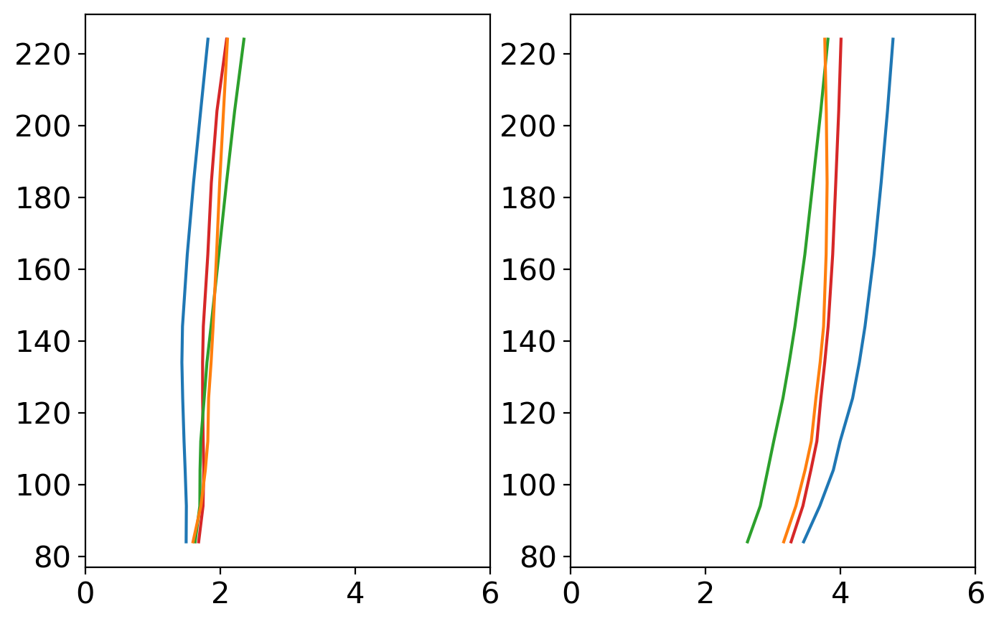

In [35]:
fig, axs = plt.subplots(
    1, 2, figsize=(8, 5), 
    dpi=100,
)
axs = axs.ravel()
base_colors = [
    'tab:red',
    'tab:green',
    'tab:blue',
    'tab:orange',
    'tab:purple',
    'tab:brown',
    'tab:pink',
    'tab:cyan'
] 
for i in np.arange(ncluster):
    v = lidar_clusters[i]['uv']
    v = v.groupby(v['time.hour']).mean()
    vv = v.isel(hour=[4,5,6,7,8,9,10,11,12,13,14,15,16]).mean('hour')
    axs[0].plot(vv, vv.level, c=base_colors[i], label=f'Node{i+1}')
    vv = v.isel(hour=[16,17,18,19,20,21,22,23,0]).mean('hour')
    axs[1].plot(vv, vv.level, c=base_colors[i], label=f'Node{i+1}')
    axs[0].set_xlim(0,6)
    axs[1].set_xlim(0,6)
axs[1].legend(fontsize=5)


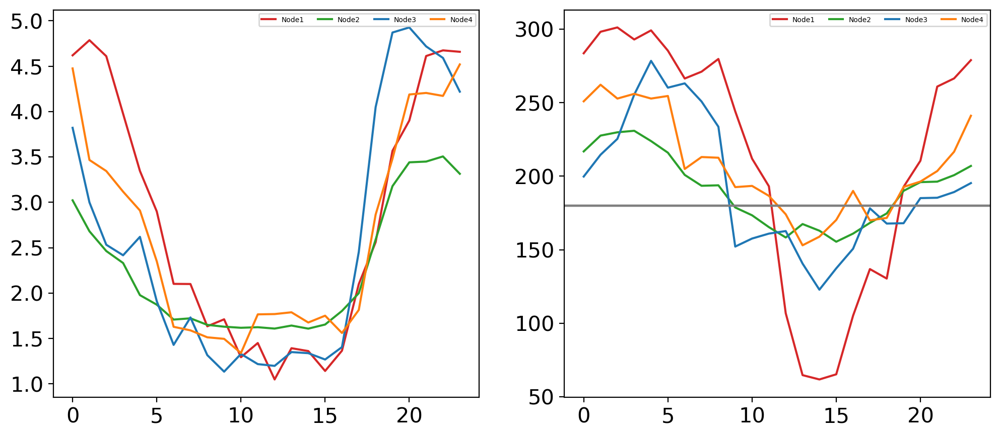

In [ ]:
fig, axs = plt.subplots(
    1, 2, figsize=(12, 5), 
    dpi=100,
)

ax = axs[0]
for i in np.arange(ncluster):
    v = lidar_clusters[i].sel(level=104)['uv']
    v = v.groupby(v['time.hour']).mean()
    ax.plot(v.hour, v, c=base_colors[i], label=f'Node{i+1}')
ax.legend(fontsize=5, ncol=4)

ax = axs[1]
for i in np.arange(ncluster):
    v = lidar_clusters[i].sel(level=104)['wdir']
    v = v.groupby(v['time.hour']).mean()
    ax.plot(v.hour, v, c=base_colors[i], label=f'Node{i+1}')
    ax.axhline(180, c='tab:gray')
ax.legend(fontsize=5, ncol=4)


In [32]:
def plot_cross_section(data, u=None, v=None, **kwargs):
    mpl.rcParams['font.size'] = 15
    mpl.rcParams['font.family'] = 'Helvetica'  
    
    # create a figure
    if (fig:=kwargs.get('fig')) is None:  
        fig = plt.figure(figsize=(8, 5))
    if (ax:=kwargs.get('ax')) is None:  ax = plt.axes()
    ax.set_axis_on()
    
    # # set map - extent, grid, coastline ...
    # draw_xlabel = kwargs.get('draw_xlabel', True)
    # draw_ylabel = kwargs.get('draw_ylabel', True)

    # plot_map.set_map(
    #     ax,
    #     extent=kwargs.get('extent',[-125+360,-70+360,24,50]),
    #     gridlines_kw=dict(
    #         xticks=[-126,-124,-122,-120,-118,-116,-114,-112],
    #         yticks=[40,42,44,46,48,50],
    #         linestyle=":", alpha=0.5,
    #     ),
    #     gridlabels_kw=dict(
    #         xticks=[-126,-124,-122,-120,-118,-116,-114,-112] if draw_xlabel else [],
    #         yticks=[40,42,44,46,48,50] if draw_ylabel else [],
    #     ),
    #     boundary_kw=dict(
    #         draw_state=True,
    #         coastline_kw=dict(linewidth=0.9, alpha=0.7, color='k'),
    #         draw_borders=True,
    #         border_kw=dict(linewidth=0.9, alpha=0.7, color='k'),
    #     ),
    # )
    
    # lat and lon for contour plot
    if ((lon:=kwargs.get('lon')) is None): lon = data['lon']
    if ((lat:=kwargs.get('lat')) is None): lat = data['lat']
        
    # draw contourf
    cmap = kwargs.get('cmap', "WhiteBlueGreenYellowRed")
    clev = kwargs.get('clev', np.arange(0, 40, 1))

    # cs, clev = plot_map.add_contourf(
    cs, clev = plot_map.add_pcolormesh(
        ax, lon, lat, data,
        cmap=cmap,clev=clev,
        nomap=True,
    )
    # cs = ax.contourf(lon, lat, data, cmap=cm_wind['cmap'], norm=cm_wind['norm'], clev=clev)
    if (u is not None) & (v is not None):
        d = 1
        _lat = lat[::d]#,::d]
        _lon = lon[::d]#,::d]
        # uu, vv = rotate_wind(u[::d,::d], v[::d,::d], _lon)
        uu, vv = u[::d,::d].data, v[::d,::d].data
        vec = plot_map.add_vector(ax,
            _lon.data, _lat.data, uu, vv,
            vector_kwargs=dict(
                scale_units="inches", scale=kwargs.get('vector_scale',15),
            ),
            nomap=True,
        )
        rect = mpl.patches.Rectangle(
            (0., 0),  # (x, y)
            0.25,  # width
            0.1,  # height
            facecolor='white',
            edgecolor='gray',
            transform=ax.transAxes,
        )
        ax.add_patch(rect)
        ax.quiverkey(vec, 0.10, 0.05, 5, "5",labelpos='E', coordinates='axes')
    
    if (overlay:=kwargs.get('overlay')) is not None:
        plot_map.add_hatches(ax, lon, lat, overlay, clev=[0, 0.05], zorder=10)
        
    # draw urban
    # plot_map.add_contour(ax, XLON, XLAT, xlc.where(xlc==5,0), colors='gray', clev=[4.9,5.0,5.1], linewidths=0.8)
        
    # add text - title, ananote
    if (title:=kwargs.get('title')) is not None: 
        default_title_kwargs = dict(loc='left')
        default_title_kwargs.update(kwargs.get('title_kwargs', {}))
        ax.set_title(title, **default_title_kwargs)

    if kwargs.get('draw_colorbar'):
        plot_map.add_colorbar(cs, ax, clev[1:-1])
        
    return cs, clev 

In [ ]:
cross_section['wdir'].min()

NameError: name 'cross_section' is not defined

In [ ]:
np.cos(np.pi/4)

0.7071067811865476

IndexError: list index out of range

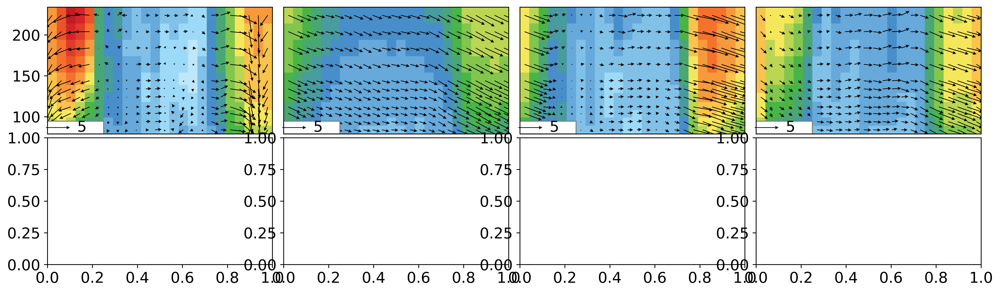

In [33]:
fig, axs = plt.subplots(
    2, 4, figsize=(14, 4), 
    dpi=300,
)
axs = axs.ravel()
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.98, top=0.95, hspace=0.03, wspace=0.05)
for i in np.arange(ncluster):
    cross_section = lidar_clusters[i]
    cross_section = cross_section.groupby(cross_section['time.hour']).mean()
    # print(cross_section)
    plot_cross_section(
        cross_section['uv'].T, 
        lat=cross_section.level, lon=cross_section.hour, 
        fig=fig, ax=axs[i],
        clev=[-10000]+list(np.linspace(0,8,21))+[10000],
        u=-cross_section['uv'].T * np.cos(cross_section['wdir'].T * np.pi /180.), v=cross_section['w'].T *10,
        draw_xlabel=True if i in [4,5,6,7] else False,
        draw_ylabel=True if i in [0,4] else False,
    )
    if i not in [4,5,6,7]: axs[i].set_xticks([])
    if i not in [0,4]: axs[i].set_yticks([])
